# Сверточные нейронные сети (CNN). Компьютерное зрение. Задача классификации изображений

In [ ]:
import tensorflow as tf

train_ds, test_ds = tf.keras.utils.image_dataset_from_directory(
    "D:\PythonWork\OldZmiy\ElfPythonProject\data\data3\data3",
    validation_split=0.2, 
    subset="both",
    seed=42, 
    image_size=(200,400),
    batch_size=32,
)

Found 2000 files belonging to 2 classes.
Using 1600 files for training.
Using 400 files for validation.


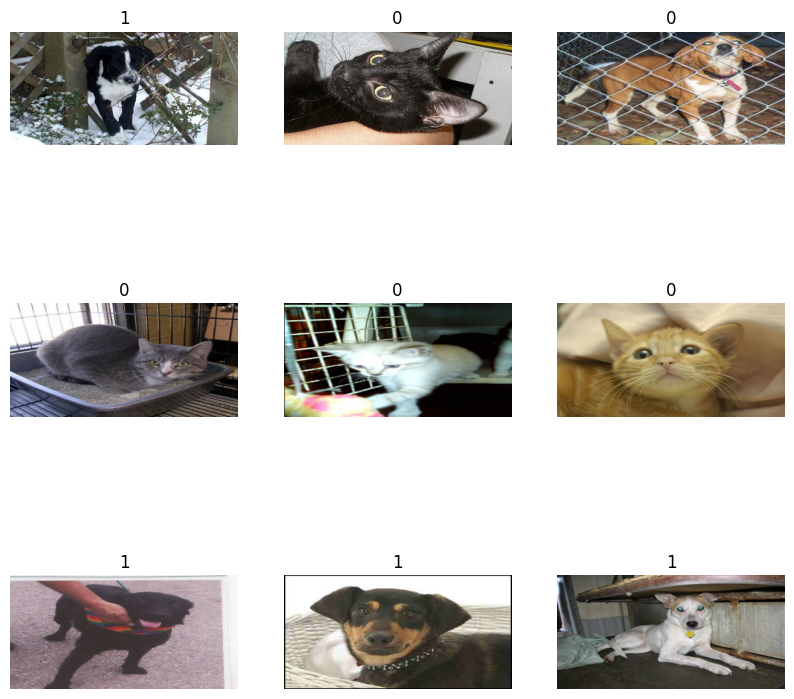

In [ ]:
import matplotlib.pyplot as plt

plt.figure(figsize=(10, 10))
for images, labels in train_ds.take(1):
    for i in range(9):
        ax = plt.subplot(3, 3, i + 1)
        plt.imshow(images[i].numpy().astype("uint8"))
        plt.title(int(labels[i]))
        plt.axis("off")

## Аугментация данных

In [3]:
data_augmentation = tf.keras.Sequential(
    [
        tf.keras.layers.RandomFlip("horizontal"),
        tf.keras.layers.RandomRotation(0.1),
    ]
)

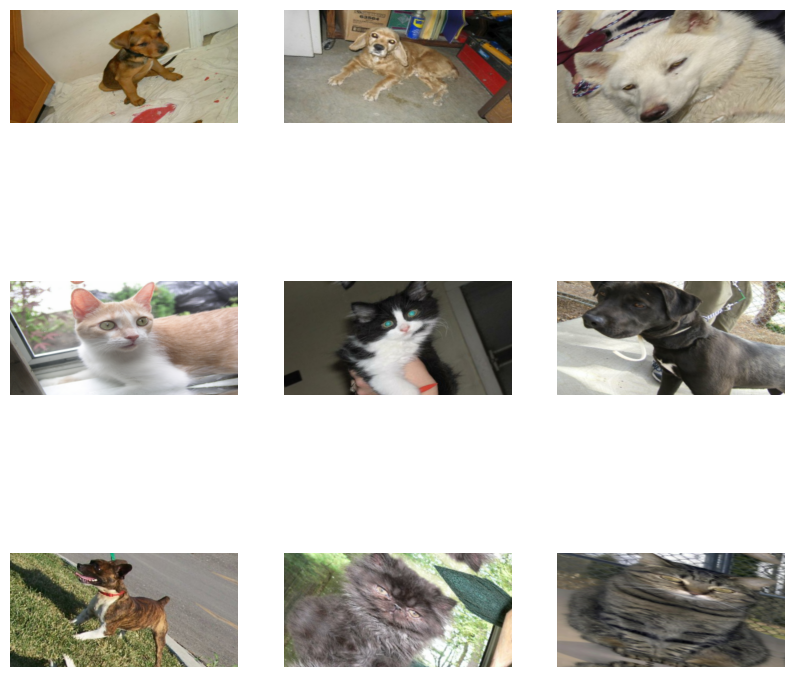

In [4]:
plt.figure(figsize=(10, 10))
for images, _ in train_ds.take(1):
    for i in range(9):
        augmented_images = data_augmentation(images)
        ax = plt.subplot(3, 3, i + 1)
        plt.imshow(augmented_images[i].numpy().astype("uint8"))
        plt.axis("off")

In [5]:
train_ds = train_ds.map(
    lambda img, label: (data_augmentation(img), label)
)

In [ ]:
inputs = tf.keras.Input(shape=(200, 400, 3))

augmented_inputs = tf.keras.Sequential([
    tf.keras.layers.RandomFlip("horizontal"),
    tf.keras.layers.RandomRotation(0.1),
    tf.keras.layers.RandomZoom((0.1, 0.1))
])(inputs)

x = tf.keras.layers.Rescaling(1./255)(augmented_inputs)

x = tf.keras.layers.Conv2D(64, 3, strides=2, padding="same")(x)
x = tf.keras.layers.BatchNormalization()(x)
x = tf.keras.layers.Activation("relu")(x)

x = tf.keras.layers.MaxPooling2D(3, strides=2, padding="same")(x)

x = tf.keras.layers.Conv2D(128, 4, strides=2, padding="same")(x)
x = tf.keras.layers.BatchNormalization()(x)
x = tf.keras.layers.Activation("relu")(x)

x = tf.keras.layers.MaxPooling2D(3, strides=2, padding="same")(x)

x = tf.keras.layers.Flatten()(x)

x = tf.keras.layers.Dropout(0.5)(x)

l2_reg = tf.keras.regularizers.l2()
x = tf.keras.layers.Dense(64, kernel_regularizer=l2_reg, activation="relu")(x)

outputs = tf.keras.layers.Dense(2, activation="softmax")(x)

model = tf.keras.Model(inputs, outputs)

model.compile(optimizer="adam",
              loss="categorical_crossentropy",
              metrics=["accuracy"])

In [7]:
model.summary()

Model: "functional_2"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer_1 (InputLayer)      │ (None, 200, 400, 3)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ sequential_1 (Sequential)       │ (None, 200, 400, 3)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ rescaling (Rescaling)           │ (None, 200, 400, 3)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d (Conv2D)                 │ (None, 100, 200, 64)   │         1,792 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization             │ (None, 100, 200, 64)   │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation (Activation)         │ (None, 100, 200, 64)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d (MaxPooling2D)    │ (None, 50, 100, 64)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_1 (Conv2D)               │ (None, 25, 50, 128)    │       131,200 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_1           │ (None, 25, 50, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ activation_1 (Activation)       │ (None, 25, 50, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_1 (MaxPooling2D)  │ (None, 13, 25, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten (Flatten)               │ (None, 41600)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout (Dropout)               │ (None, 41600)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense (Dense)                   │ (None, 64)             │     2,662,464 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_1 (Dense)                 │ (None, 2)              │           130 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 2,796,354 (10.67 MB)

 Trainable params: 2,795,970 (10.67 MB)

 Non-trainable params: 384 (1.50 KB)

In [ ]:
model.compile(optimizer=tf.keras.optimizers.Adam(1e-3), loss="sparse_categorical_crossentropy", metrics=["accuracy"])

In [ ]:
model.fit(train_ds, epochs=5, validation_data=test_ds)

Epoch 1/5
50/50 ━━━━━━━━━━━━━━━━━━━━ 79s 1s/step - accuracy: 0.5226 - loss: 7.0977 - val_accuracy: 0.5525 - val_loss: 1.8165
Epoch 2/5
50/50 ━━━━━━━━━━━━━━━━━━━━ 75s 1s/step - accuracy: 0.5787 - loss: 1.9043 - val_accuracy: 0.5300 - val_loss: 1.4432
Epoch 3/5
50/50 ━━━━━━━━━━━━━━━━━━━━ 70s 1s/step - accuracy: 0.5846 - loss: 1.6994 - val_accuracy: 0.4550 - val_loss: 1.7786
Epoch 4/5
50/50 ━━━━━━━━━━━━━━━━━━━━ 71s 1s/step - accuracy: 0.6039 - loss: 1.2793 - val_accuracy: 0.5800 - val_loss: 1.0764
Epoch 5/5
50/50 ━━━━━━━━━━━━━━━━━━━━ 70s 1s/step - accuracy: 0.6283 - loss: 1.1258 - val_accuracy: 0.5250 - val_loss: 1.0297


In [10]:
def cat_or_dog(preds):
    if preds[0][0] > preds[0][1]:
        print('Это кошка!')
    else:
        print('Это собака!')

In [ ]:
import tensorflow as tf
import matplotlib.pyplot as plt

def who_on_image(image_name):
    full_path = f"D:/PythonWork/OldZmiy/ElfPythonProject/data/cats_and_dogs/{image_name}"
    
    img = tf.keras.preprocessing.image.load_img(full_path, target_size=(200, 400))
    
    img_array = tf.keras.preprocessing.image.img_to_array(img)

    plt.imshow(img_array.astype('uint8'))
    plt.axis('off')
    plt.title(f"Image: {image_name}")
    plt.show()

    img_array = tf.expand_dims(img_array, axis=0)

    predictions = model.predict(img_array)

    print(predictions)
    cat_or_dog(predictions)

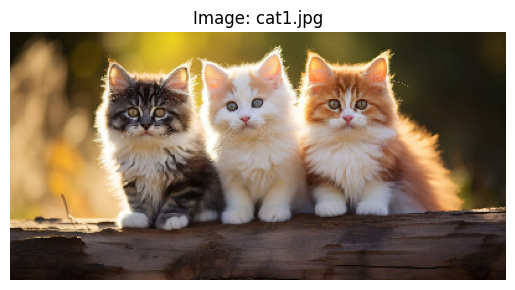

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step
[[0.56274235 0.43725765]]
Это кошка!


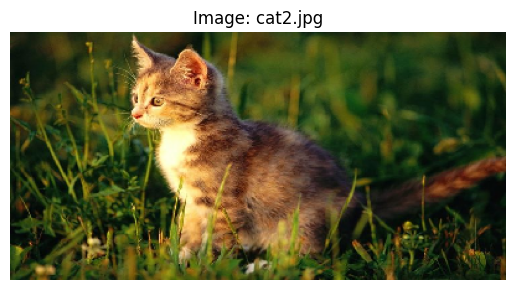

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 50ms/step
[[0.4288767 0.5711233]]
Это собака!


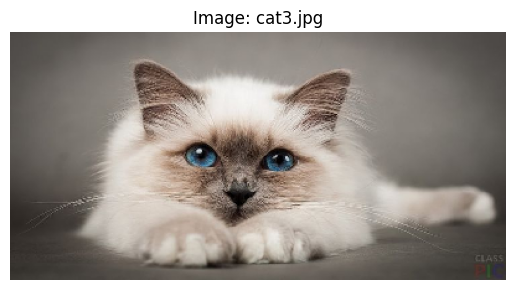

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 50ms/step
[[0.60555375 0.39444622]]
Это кошка!


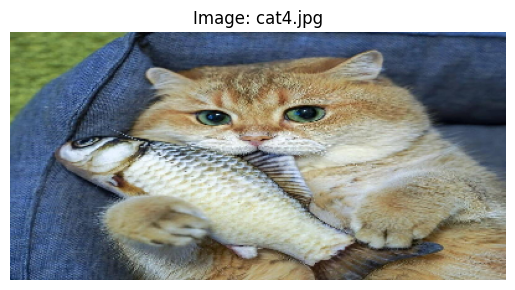

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 73ms/step
[[0.67851233 0.3214877 ]]
Это кошка!


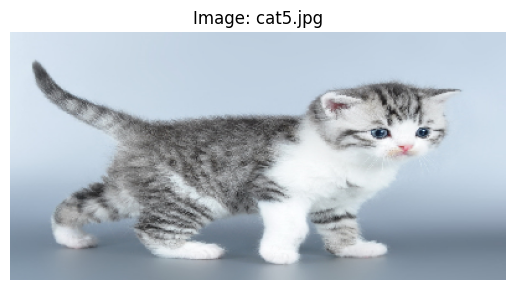

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 48ms/step
[[0.6262564 0.3737436]]
Это кошка!


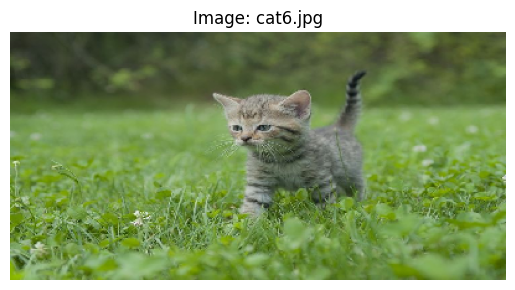

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 50ms/step
[[0.404825  0.5951751]]
Это собака!


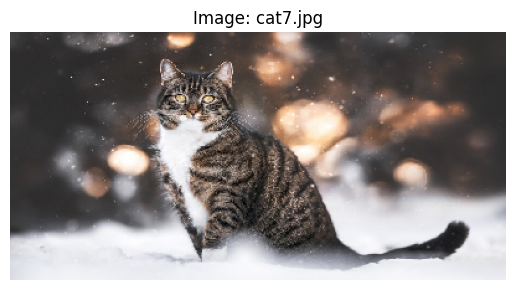

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step
[[0.71755 0.28245]]
Это кошка!


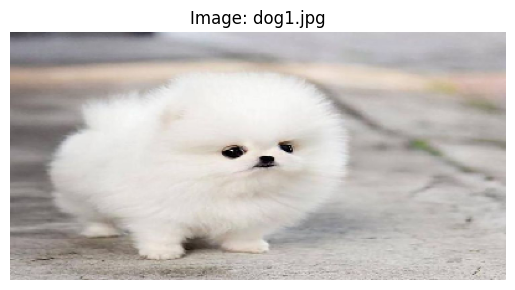

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 45ms/step
[[0.7897809  0.21021913]]
Это кошка!


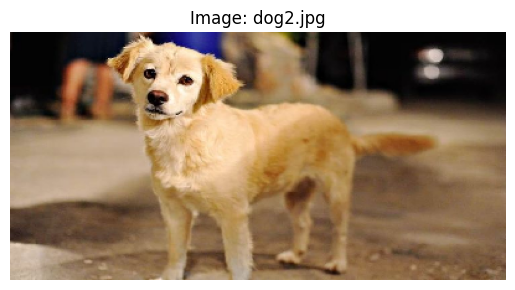

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step
[[0.7348351  0.26516488]]
Это кошка!


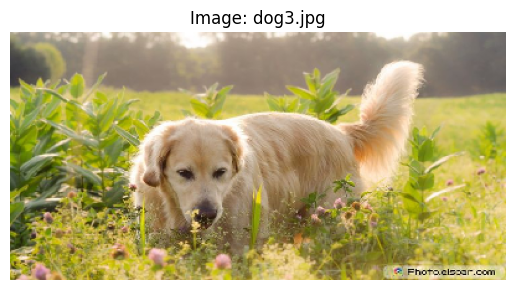

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step
[[0.38590357 0.61409634]]
Это собака!


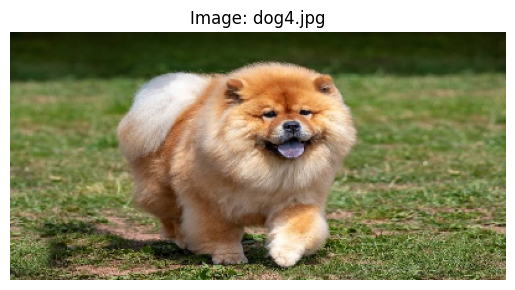

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step
[[0.26709747 0.7329026 ]]
Это собака!


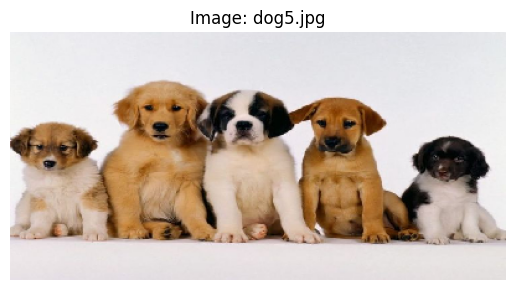

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 101ms/step
[[0.71087706 0.289123  ]]
Это кошка!


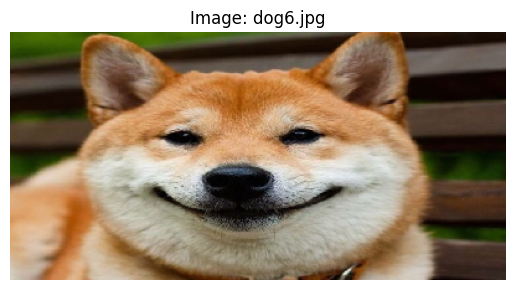

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 111ms/step
[[0.6329278  0.36707222]]
Это кошка!


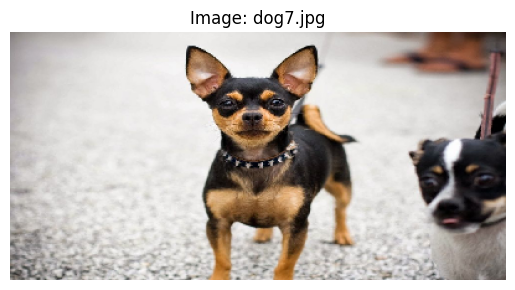

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 74ms/step
[[0.68129545 0.31870458]]
Это кошка!


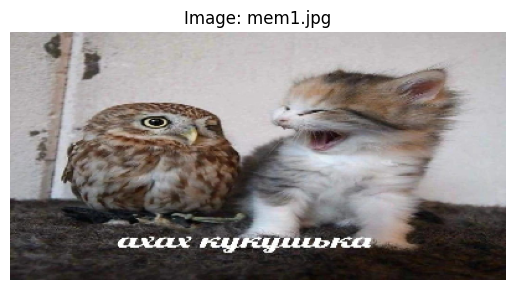

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 72ms/step
[[0.5942849  0.40571517]]
Это кошка!


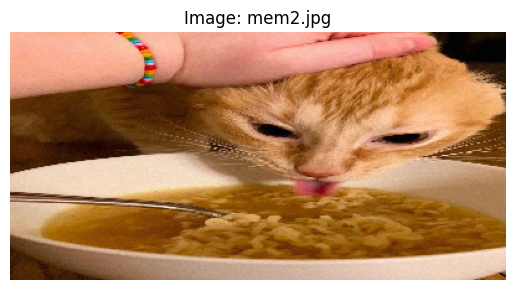

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step
[[0.5319565  0.46804345]]
Это кошка!


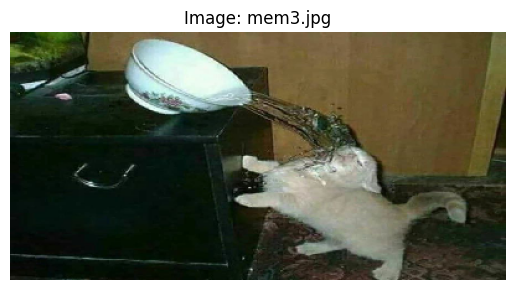

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 80ms/step
[[0.6494424  0.35055768]]
Это кошка!


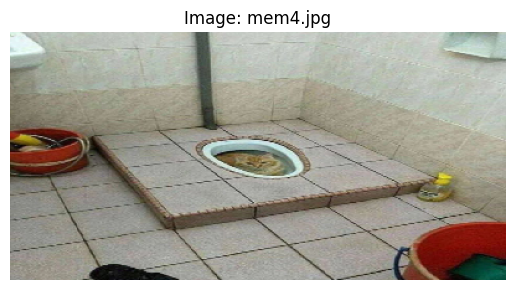

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 94ms/step
[[0.7728375  0.22716245]]
Это кошка!


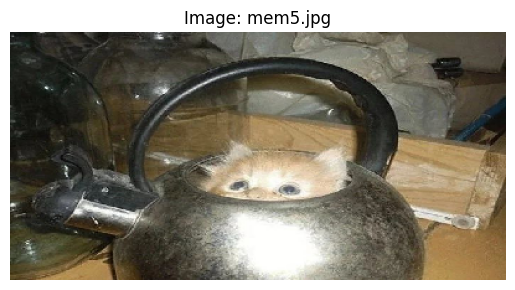

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 91ms/step
[[0.6823238 0.3176761]]
Это кошка!


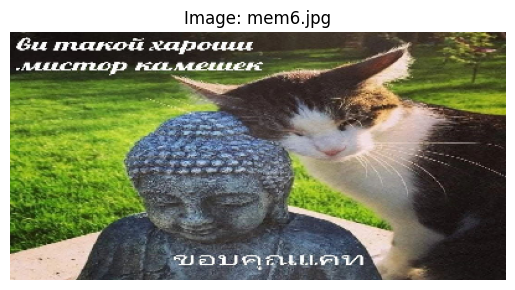

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step
[[0.491781   0.50821906]]
Это собака!


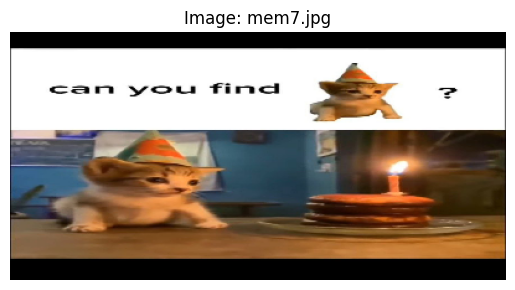

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 105ms/step
[[0.35570598 0.644294  ]]
Это собака!


In [12]:
for animal in ['cat', 'dog', 'mem']:
    for i in range(1, 8):
        who_on_image(f'{animal}{i}.jpg')

### Вывод

1) <b>Аугментация данных</b>

    Последовательность операций выстраивается следующим образом:

    Сначала изображение проходит этап горизонтального переворота слева направо.

    Далее применяется случайный поворот на небольшой угол.

    И в конце происходит случайное масштабирование.

    Такой подход позволяет увеличить разнообразие представленных данных, облегчая обучение модели, особенно в ситуациях с малым объемом исходных данных.

2) <b>Слои CNN</b>

    1. _Входной слой_

        Этот слой объявляет входной формат данных нашей модели. Размер (200, 400, 3) обозначает, что наши изображения имеют высоту 200 пикселей, ширину 400 пикселей и глубину 3 канала (RGB).

    2. _Блок аугментации данных_

        Здесь создается последовательность аугментирующих слоев, которые применяются к входящим изображениям.

    3. _Норма пикселей (Rescaling)_

        Этот слой делит каждый пиксель изображения на 255, нормализуя значения пикселей в диапазоне [0,1]. Это облегчает обучение, так как большинство алгоритмов машинного обучения работают эффективнее с нормализованными значениями.

    4. _Свертка_

        Выполняет свертку изображения фильтром размером 3×3 и создаёт 64 карты признаков. Каждый фильтр выделяет важные пространственные особенности (границы, края, текстуры и т.д.). Параметр strides=2 заставляет фильтр двигаться быстрее, что уменьшает разрешение вдвое.

    5. _Нормализация партии (BatchNormalization)_

        Этот слой нормализует значения активации в рамках одной партии данных, ускоряя обучение и улучшая устойчивость модели к изменению масштабов входных данных.

    6. _Активационная функция (Activation)_

        RELU (положительные значения без изменений, а отрицательные превращает в ноль)

    7. _Максимальный пулингирующий слой (MaxPooling2D)_

        Выполняет максимальное усреднение (pooling) областей изображения размером 3×3, выбирая наибольший элемент из региона. Это уменьшает размер данных и одновременно сохраняет самые важные элементы изображения.

    8. _Растворение в плоскость (Flatten)_

        Преобразует многоуровневую карту признаков в плоский вектор, готовя данные для передачи в полносвязные слои.

    9. _Регулятор шума (Dropout)_

        Во время обучения случайно отбрасывает половину нейронов (с вероятностью 50%), предотвращая переобучение и создавая лучшую способность к обобщению.

    10. _Полносвязный слой (Dense)_

        Полносвязный слой соединяет все нейроны предыдущего слоя с каждым нейроном этого слоя. L2-регуляризатор ограничивает весовые коэффициенты, уменьшая шанс переобучения. Функция активации ReLu вновь активизирует только положительные значения.

## Перенос обучения (Transfer Learning) методом тонкой настройки (Fine-Tuning)

Будем работать с датасетом, состоящем из картинок с бобрами, ежами и дикими котами

### VGG19

In [ ]:
train_ds, test_ds = tf.keras.utils.image_dataset_from_directory(
    "D:\PythonWork\OldZmiy\ElfPythonProject\data\\bober", 
    validation_split=0.15,
    subset="both", 
    seed=42, 
    image_size=(224,224),
    batch_size=32,
)

Found 134 files belonging to 3 classes.


Using 114 files for training.
Using 20 files for validation.


In [14]:
data_augmentation = tf.keras.Sequential(
    [
        tf.keras.layers.RandomFlip("horizontal"),
        tf.keras.layers.RandomRotation(0.1),
        tf.keras.layers.RandomZoom(height_factor=(-0.1, 0.1), width_factor=(-0.1, 0.1)),
    ]
)

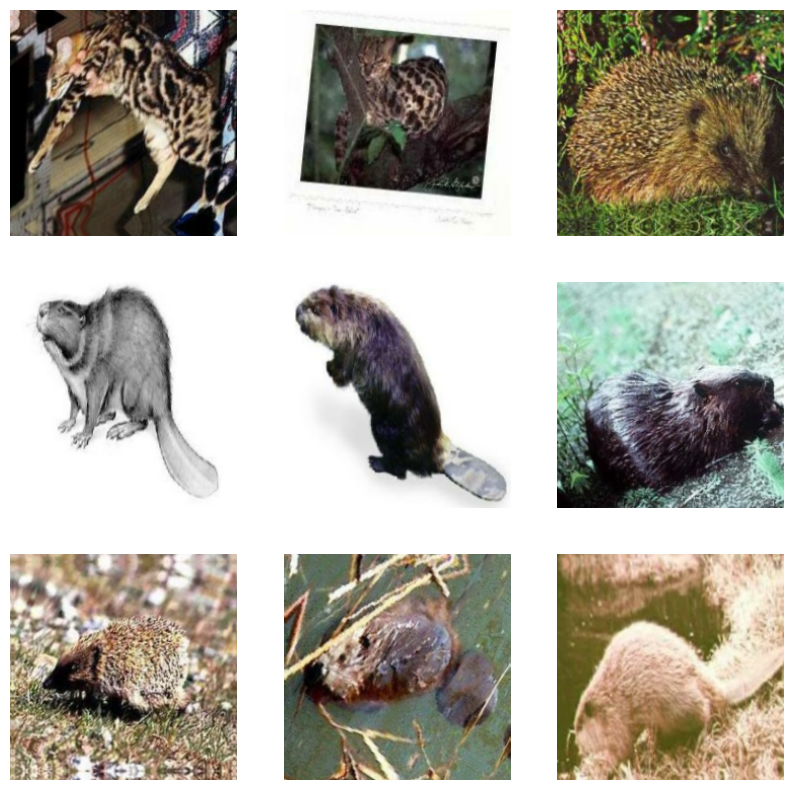

In [15]:
plt.figure(figsize=(10, 10))
for images, _ in train_ds.take(1):
    for i in range(9):
        augmented_images = data_augmentation(images)
        ax = plt.subplot(3, 3, i + 1)
        plt.imshow(augmented_images[i].numpy().astype("uint8"))
        plt.axis("off")

In [16]:
train_ds = train_ds.map(
    lambda img, label: (data_augmentation(img), label)
)

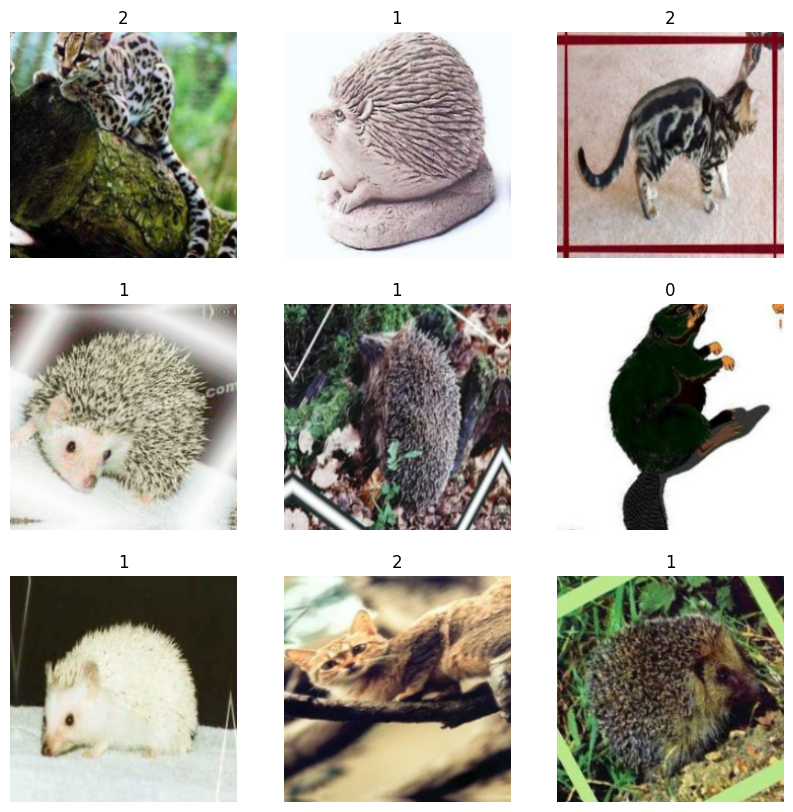

In [ ]:
plt.figure(figsize=(10, 10))
for images, labels in train_ds.take(1):
    for i in range(9):
        ax = plt.subplot(3, 3, i + 1)
        plt.imshow(images[i].numpy().astype("uint8"))
        plt.title(int(labels[i]))
        plt.axis("off")

In [18]:
vgg = tf.keras.applications.VGG19(weights='imagenet', include_top=True)
vgg.summary()

Model: "vgg19"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer_4 (InputLayer)      │ (None, 224, 224, 3)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block1_conv1 (Conv2D)           │ (None, 224, 224, 64)   │         1,792 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block1_conv2 (Conv2D)           │ (None, 224, 224, 64)   │        36,928 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block1_pool (MaxPooling2D)      │ (None, 112, 112, 64)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block2_conv1 (Conv2D)           │ (None, 112, 112, 128)  │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block2_conv2 (Conv2D)           │ (None, 112, 112, 128)  │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block2_pool (MaxPooling2D)      │ (None, 56, 56, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block3_conv1 (Conv2D)           │ (None, 56, 56, 256)    │       295,168 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block3_conv2 (Conv2D)           │ (None, 56, 56, 256)    │       590,080 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block3_conv3 (Conv2D)           │ (None, 56, 56, 256)    │       590,080 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block3_conv4 (Conv2D)           │ (None, 56, 56, 256)    │       590,080 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block3_pool (MaxPooling2D)      │ (None, 28, 28, 256)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block4_conv1 (Conv2D)           │ (None, 28, 28, 512)    │     1,180,160 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block4_conv2 (Conv2D)           │ (None, 28, 28, 512)    │     2,359,808 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block4_conv3 (Conv2D)           │ (None, 28, 28, 512)    │     2,359,808 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block4_conv4 (Conv2D)           │ (None, 28, 28, 512)    │     2,359,808 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block4_pool (MaxPooling2D)      │ (None, 14, 14, 512)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block5_conv1 (Conv2D)           │ (None, 14, 14, 512)    │     2,359,808 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block5_conv2 (Conv2D)           │ (None, 14, 14, 512)    │     2,359,808 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block5_conv3 (Conv2D)           │ (None, 14, 14, 512)    │     2,359,808 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block5_conv4 (Conv2D)           │ (None, 14, 14, 512)    │     2,359,808 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block5_pool (MaxPooling2D)      │ (None, 7, 7, 512)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten (Flatten)               │ (None, 25088)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ fc1 (Dense)                     │ (None, 4096)           │   102,764,544 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ fc2 (Dense)                     │ (None, 4096)           │    16,781,31

 Total params: 143,667,240 (548.05 MB)

 Trainable params: 143,667,240 (548.05 MB)

 Non-trainable params: 0 (0.00 B)

In [ ]:
inp = vgg.input

new_classification_layer = tf.keras.layers.Dense(3, activation='softmax')

out = new_classification_layer(vgg.layers[-2].output)

model_new = tf.keras.Model(inp, out)

model_new.summary()

Model: "functional_4"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer_4 (InputLayer)      │ (None, 224, 224, 3)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block1_conv1 (Conv2D)           │ (None, 224, 224, 64)   │         1,792 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block1_conv2 (Conv2D)           │ (None, 224, 224, 64)   │        36,928 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block1_pool (MaxPooling2D)      │ (None, 112, 112, 64)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block2_conv1 (Conv2D)           │ (None, 112, 112, 128)  │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block2_conv2 (Conv2D)           │ (None, 112, 112, 128)  │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block2_pool (MaxPooling2D)      │ (None, 56, 56, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block3_conv1 (Conv2D)           │ (None, 56, 56, 256)    │       295,168 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block3_conv2 (Conv2D)           │ (None, 56, 56, 256)    │       590,080 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block3_conv3 (Conv2D)           │ (None, 56, 56, 256)    │       590,080 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block3_conv4 (Conv2D)           │ (None, 56, 56, 256)    │       590,080 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block3_pool (MaxPooling2D)      │ (None, 28, 28, 256)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block4_conv1 (Conv2D)           │ (None, 28, 28, 512)    │     1,180,160 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block4_conv2 (Conv2D)           │ (None, 28, 28, 512)    │     2,359,808 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block4_conv3 (Conv2D)           │ (None, 28, 28, 512)    │     2,359,808 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block4_conv4 (Conv2D)           │ (None, 28, 28, 512)    │     2,359,808 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block4_pool (MaxPooling2D)      │ (None, 14, 14, 512)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block5_conv1 (Conv2D)           │ (None, 14, 14, 512)    │     2,359,808 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block5_conv2 (Conv2D)           │ (None, 14, 14, 512)    │     2,359,808 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block5_conv3 (Conv2D)           │ (None, 14, 14, 512)    │     2,359,808 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block5_conv4 (Conv2D)           │ (None, 14, 14, 512)    │     2,359,808 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block5_pool (MaxPooling2D)      │ (None, 7, 7, 512)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten (Flatten)               │ (None, 25088)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ fc1 (Dense)                     │ (None, 4096)           │   102,764,544 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ fc2 (Dense)                     │ (None, 4096)           │    16,781,31

 Total params: 139,582,531 (532.47 MB)

 Trainable params: 139,582,531 (532.47 MB)

 Non-trainable params: 0 (0.00 B)

In [20]:
# "заморозим" все слои, кроме последнего
for layer in model_new.layers:
    layer.trainable = False
model_new.layers[-1].trainable = True

model_new.compile(loss='sparse_categorical_crossentropy', optimizer='adam', metrics=['accuracy'])
model_new.summary()

Model: "functional_4"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer_4 (InputLayer)      │ (None, 224, 224, 3)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block1_conv1 (Conv2D)           │ (None, 224, 224, 64)   │         1,792 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block1_conv2 (Conv2D)           │ (None, 224, 224, 64)   │        36,928 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block1_pool (MaxPooling2D)      │ (None, 112, 112, 64)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block2_conv1 (Conv2D)           │ (None, 112, 112, 128)  │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block2_conv2 (Conv2D)           │ (None, 112, 112, 128)  │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block2_pool (MaxPooling2D)      │ (None, 56, 56, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block3_conv1 (Conv2D)           │ (None, 56, 56, 256)    │       295,168 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block3_conv2 (Conv2D)           │ (None, 56, 56, 256)    │       590,080 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block3_conv3 (Conv2D)           │ (None, 56, 56, 256)    │       590,080 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block3_conv4 (Conv2D)           │ (None, 56, 56, 256)    │       590,080 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block3_pool (MaxPooling2D)      │ (None, 28, 28, 256)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block4_conv1 (Conv2D)           │ (None, 28, 28, 512)    │     1,180,160 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block4_conv2 (Conv2D)           │ (None, 28, 28, 512)    │     2,359,808 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block4_conv3 (Conv2D)           │ (None, 28, 28, 512)    │     2,359,808 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block4_conv4 (Conv2D)           │ (None, 28, 28, 512)    │     2,359,808 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block4_pool (MaxPooling2D)      │ (None, 14, 14, 512)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block5_conv1 (Conv2D)           │ (None, 14, 14, 512)    │     2,359,808 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block5_conv2 (Conv2D)           │ (None, 14, 14, 512)    │     2,359,808 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block5_conv3 (Conv2D)           │ (None, 14, 14, 512)    │     2,359,808 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block5_conv4 (Conv2D)           │ (None, 14, 14, 512)    │     2,359,808 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block5_pool (MaxPooling2D)      │ (None, 7, 7, 512)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten (Flatten)               │ (None, 25088)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ fc1 (Dense)                     │ (None, 4096)           │   102,764,544 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ fc2 (Dense)                     │ (None, 4096)           │    16,781,31

 Total params: 139,582,531 (532.47 MB)

 Trainable params: 12,291 (48.01 KB)

 Non-trainable params: 139,570,240 (532.42 MB)

In [21]:
model_new.fit(train_ds, epochs=5, validation_data=test_ds)

Epoch 1/5
4/4 ━━━━━━━━━━━━━━━━━━━━ 37s 8s/step - accuracy: 0.3040 - loss: 1.9824 - val_accuracy: 0.8000 - val_loss: 0.4683
Epoch 2/5
4/4 ━━━━━━━━━━━━━━━━━━━━ 31s 8s/step - accuracy: 0.8582 - loss: 0.3741 - val_accuracy: 0.9000 - val_loss: 0.1651
Epoch 3/5
4/4 ━━━━━━━━━━━━━━━━━━━━ 31s 8s/step - accuracy: 0.8666 - loss: 0.2890 - val_accuracy: 1.0000 - val_loss: 0.0350
Epoch 4/5
4/4 ━━━━━━━━━━━━━━━━━━━━ 32s 8s/step - accuracy: 0.9610 - loss: 0.0905 - val_accuracy: 1.0000 - val_loss: 0.0216
Epoch 5/5
4/4 ━━━━━━━━━━━━━━━━━━━━ 38s 7s/step - accuracy: 0.9606 - loss: 0.1509 - val_accuracy: 1.0000 - val_loss: 0.0193


In [11]:
def wild_animals(preds):
    if max(preds[0]) == preds[0][0]:
        print('Это бобер!')
    elif max(preds[0]) == preds[0][1]:
        print('Это ежик!')
    else:
        print('Это дикая кошка!')

In [8]:
def who_on_image_bober(image_name, size, mdl):
    full_path = f"D:/PythonWork/OldZmiy/ElfPythonProject/data/bober_ej_wcat/{image_name}"
    
    img = tf.keras.preprocessing.image.load_img(full_path, target_size=(size, size))
    img_array = tf.keras.preprocessing.image.img_to_array(img)

    plt.imshow(img_array.astype('uint8'))
    plt.axis('off')
    plt.title(f"Image: {image_name}")
    plt.show()

    img_array = tf.expand_dims(img_array, axis=0)

    predictions = mdl.predict(img_array)

    print(predictions)
    wild_animals(predictions)

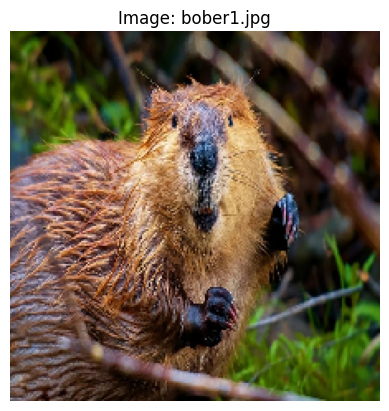

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 584ms/step
[[8.1288308e-01 1.8696645e-01 1.5050892e-04]]
Это бобер!


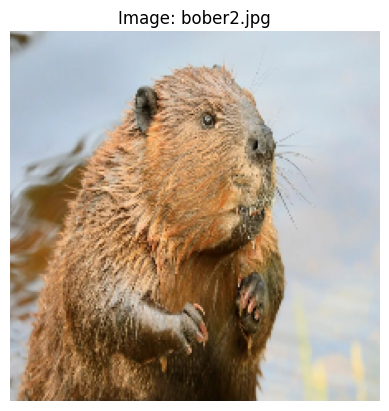

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 418ms/step
[[9.9954456e-01 4.5496860e-04 5.1305869e-07]]
Это бобер!


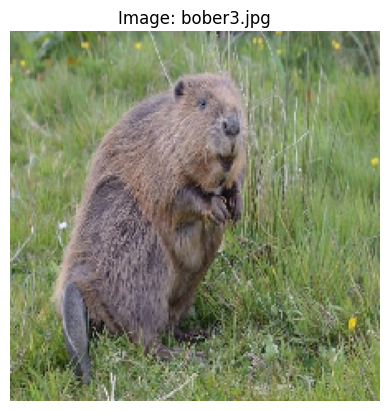

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 422ms/step
[[9.9930072e-01 6.9920352e-04 1.3446063e-07]]
Это бобер!


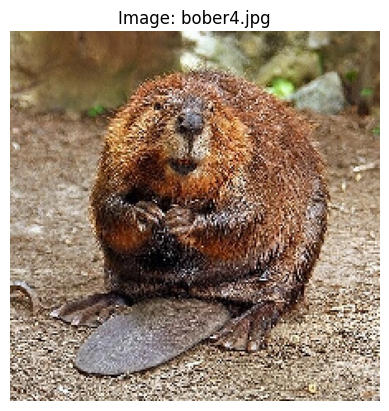

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 408ms/step
[[9.7097439e-01 2.9024694e-02 8.8871792e-07]]
Это бобер!


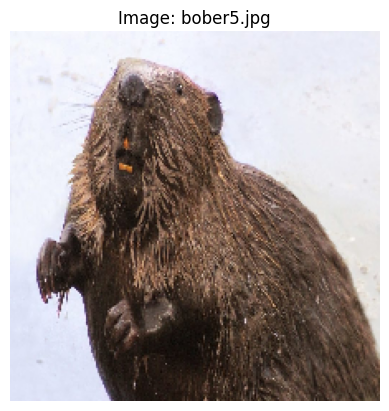

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 414ms/step
[[9.9999774e-01 5.9454771e-07 1.6966446e-06]]
Это бобер!


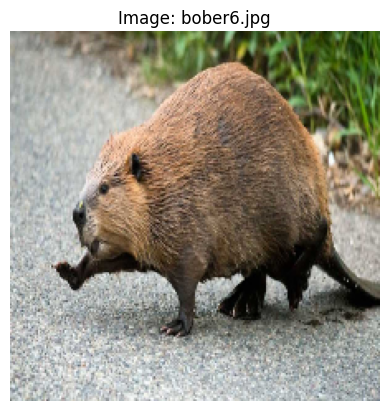

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 657ms/step
[[9.0728390e-01 9.2708156e-02 8.0403997e-06]]
Это бобер!


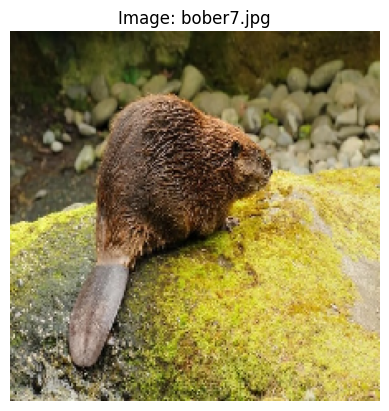

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 549ms/step
[[1.5629654e-01 8.4342557e-01 2.7781876e-04]]
Это ежик!


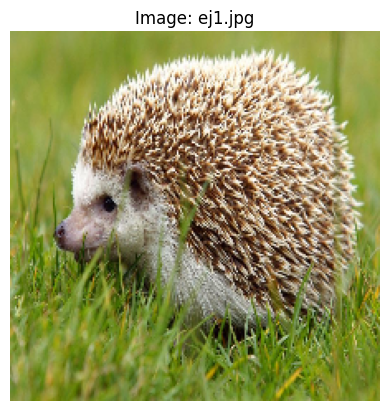

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 434ms/step
[[1.0272057e-07 9.9999988e-01 2.1192669e-11]]
Это ежик!


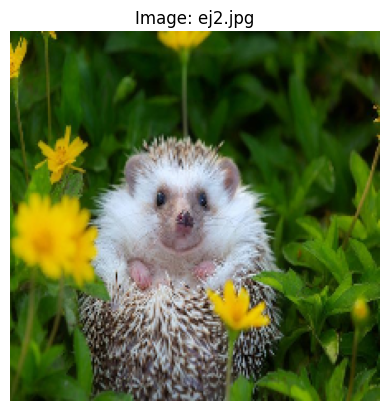

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 409ms/step
[[0.18599667 0.8110997  0.00290368]]
Это ежик!


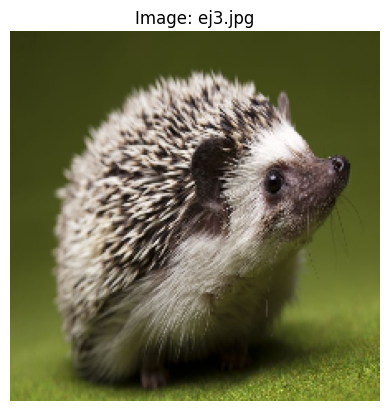

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 450ms/step
[[2.5684449e-05 9.9997437e-01 1.0389178e-09]]
Это ежик!


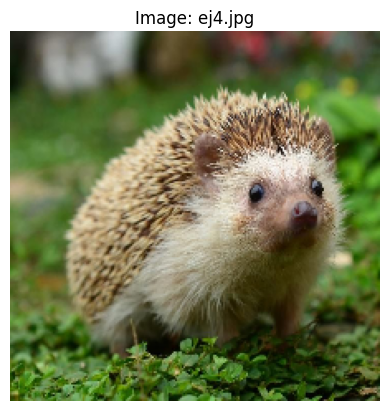

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 481ms/step
[[3.8089991e-05 9.9996185e-01 9.9453512e-09]]
Это ежик!


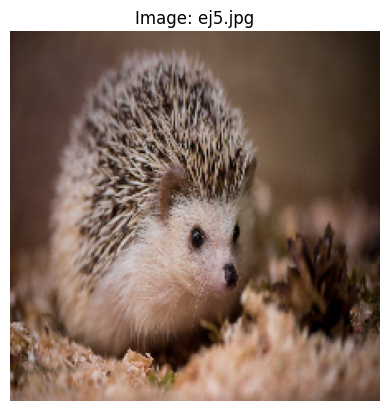

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 481ms/step
[[1.25141605e-05 9.99987483e-01 3.48744855e-09]]
Это ежик!


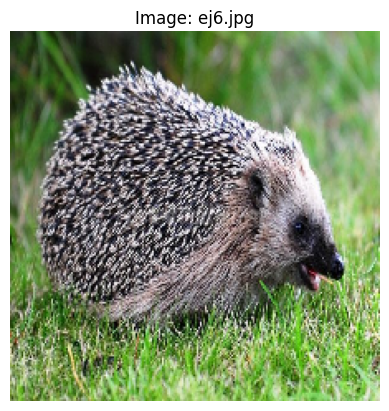

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 441ms/step
[[2.5138272e-07 9.9999976e-01 1.8803227e-10]]
Это ежик!


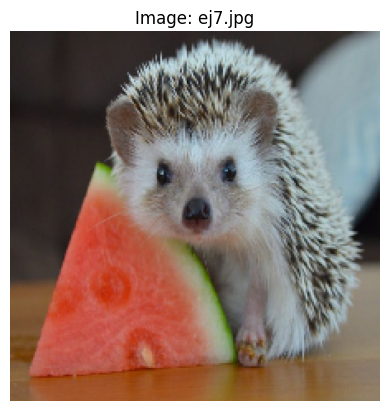

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 498ms/step
[[1.4545381e-04 9.9984407e-01 1.0486508e-05]]
Это ежик!


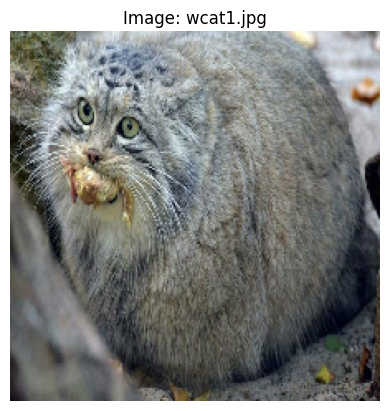

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 514ms/step
[[9.4801390e-01 2.3665982e-04 5.1749483e-02]]
Это бобер!


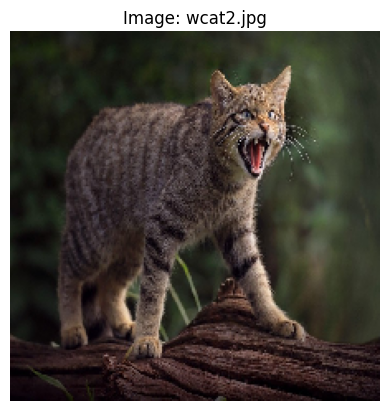

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 587ms/step
[[5.616796e-05 1.951576e-05 9.999243e-01]]
Это дикая кошка!


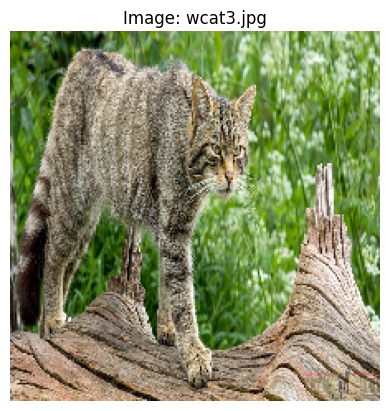

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 614ms/step
[[3.856511e-05 5.596588e-06 9.999558e-01]]
Это дикая кошка!


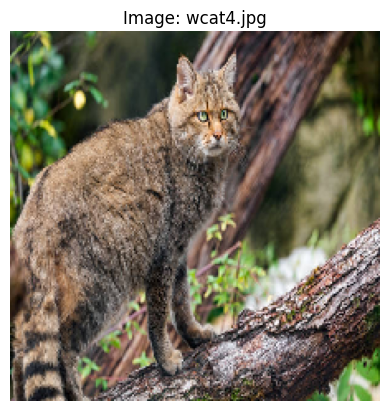

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 703ms/step
[[1.9344334e-01 7.2314921e-05 8.0648434e-01]]
Это дикая кошка!


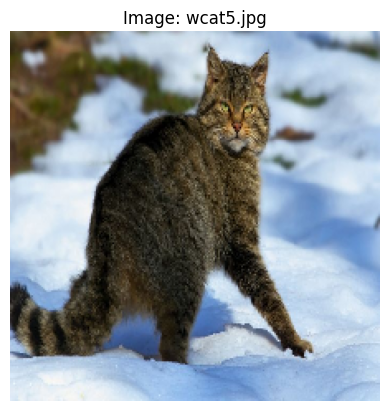

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 537ms/step
[[0.5221825  0.00860162 0.4692159 ]]
Это бобер!


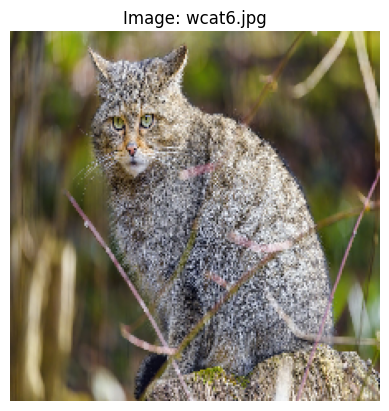

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 451ms/step
[[9.2033930e-05 3.4495464e-03 9.9645835e-01]]
Это дикая кошка!


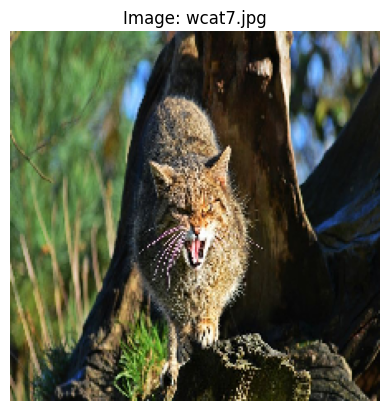

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 510ms/step
[[1.2691782e-02 3.5080848e-05 9.8727310e-01]]
Это дикая кошка!


In [24]:
for animal in ['bober', 'ej', 'wcat']:
    for i in range(1, 8):
        who_on_image_bober(f'{animal}{i}.jpg', 224, model_new)

### InceptionV3 

In [ ]:
import tensorflow as tf

data_augmentation = tf.keras.Sequential([
    tf.keras.layers.RandomFlip("horizontal"),
    tf.keras.layers.RandomRotation(0.1),
    tf.keras.layers.RandomZoom(0.1)
])

train_ds = train_ds.map(lambda x, y: (data_augmentation(x), y))

In [ ]:
import tensorflow as tf
from tensorflow.keras.applications.inception_v3 import preprocess_input
from tensorflow.keras.callbacks import EarlyStopping

iv3 = tf.keras.applications.InceptionV3(weights='imagenet', include_top=False, pooling='avg')

x = tf.keras.layers.Flatten()(iv3.output)
x = tf.keras.layers.Dense(64, activation='relu', name='dense_one')(x)
x = tf.keras.layers.Dropout(0.5, name='dropout_one')(x)
x = tf.keras.layers.Dense(64, activation='relu', name='dense_two')(x)
x = tf.keras.layers.Dropout(0.5, name='dropout_two')(x)
top_model=tf.keras.layers.Dense(3, activation='softmax', name='output')(x)
model3 = tf.keras.Model(inputs=iv3.input, outputs=top_model)

for layer in model3.layers[:-2]:
    layer.trainable = False
for layer in model3.layers[-2:]:
    layer.trainable = True

model3.compile(optimizer=tf.keras.optimizers.Adam(learning_rate=0.0001),  # Снижение learning rate для тонкой настройки
               loss='sparse_categorical_crossentropy',
               metrics=['accuracy'])

early_stopping_cb = EarlyStopping(monitor='val_loss', patience=5, restore_best_weights=True)

train_ds = train_ds.map(lambda x, y: (preprocess_input(x), y))
test_ds = test_ds.map(lambda x, y: (preprocess_input(x), y))

history = model3.fit(train_ds, epochs=5, validation_data=test_ds, callbacks=[early_stopping_cb])

Epoch 1/5
4/4 ━━━━━━━━━━━━━━━━━━━━ 16s 3s/step - accuracy: 0.3298 - loss: 1.1405 - val_accuracy: 0.3500 - val_loss: 1.0926
Epoch 2/5
4/4 ━━━━━━━━━━━━━━━━━━━━ 7s 2s/step - accuracy: 0.3908 - loss: 1.1428 - val_accuracy: 0.3500 - val_loss: 1.0926
Epoch 3/5
4/4 ━━━━━━━━━━━━━━━━━━━━ 7s 2s/step - accuracy: 0.3354 - loss: 1.1298 - val_accuracy: 0.3500 - val_loss: 1.0926
Epoch 4/5
4/4 ━━━━━━━━━━━━━━━━━━━━ 7s 2s/step - accuracy: 0.3099 - loss: 1.1375 - val_accuracy: 0.3500 - val_loss: 1.0926
Epoch 5/5
4/4 ━━━━━━━━━━━━━━━━━━━━ 8s 2s/step - accuracy: 0.3646 - loss: 1.1086 - val_accuracy: 0.3500 - val_loss: 1.0925


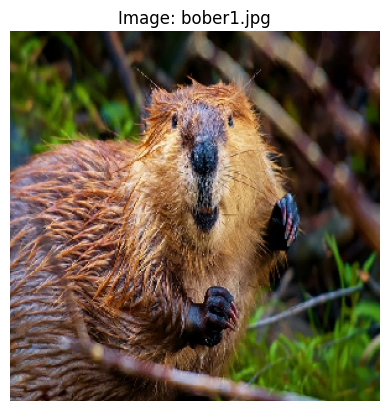

1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step
[[7.1309738e-02 1.8593411e-04 9.2850429e-01]]
Это дикая кошка!


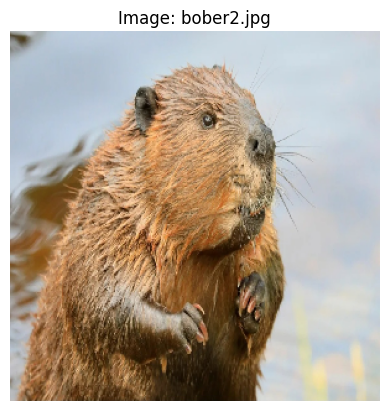

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 111ms/step
[[9.9390185e-01 1.2300695e-05 6.0858554e-03]]
Это бобер!


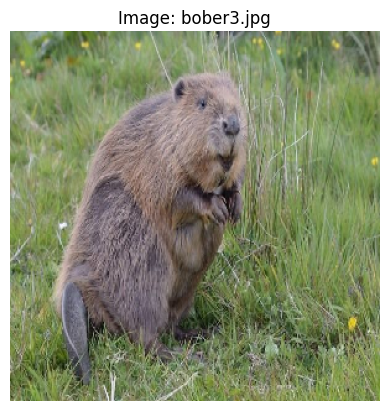

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step
[[1.8748492e-01 1.1340895e-05 8.1250376e-01]]
Это дикая кошка!


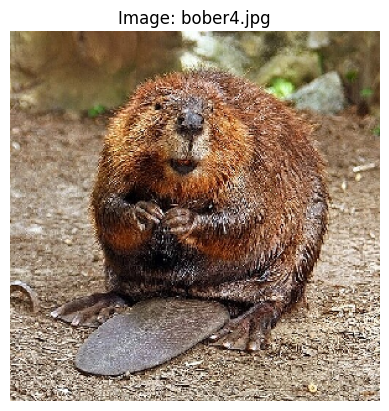

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 108ms/step
[[9.2831141e-01 1.0142153e-05 7.1678437e-02]]
Это бобер!


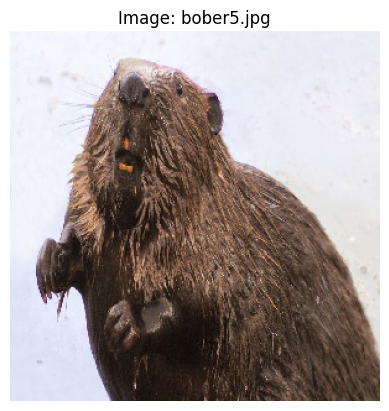

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 96ms/step
[[9.9986064e-01 1.1511299e-04 2.4255240e-05]]
Это бобер!


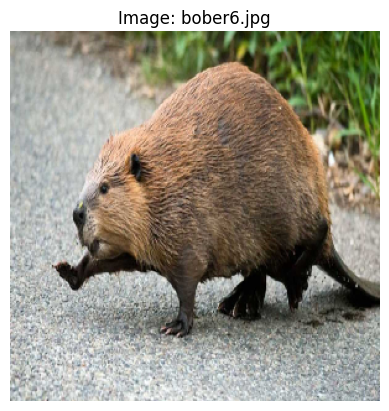

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 90ms/step
[[1.2259003e-01 8.7730169e-01 1.0831555e-04]]
Это ежик!


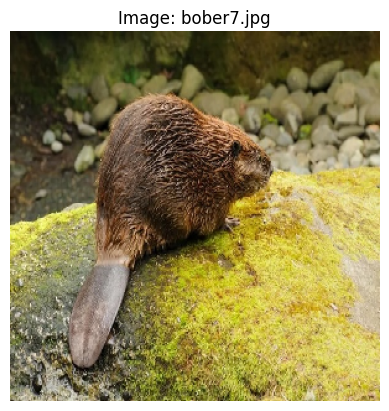

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step
[[0.08707699 0.01524414 0.89767885]]
Это дикая кошка!


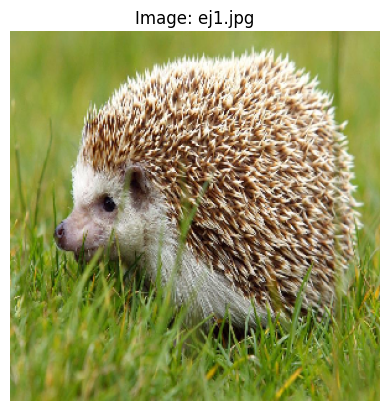

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 102ms/step
[[2.6981723e-02 1.7872903e-08 9.7301835e-01]]
Это дикая кошка!


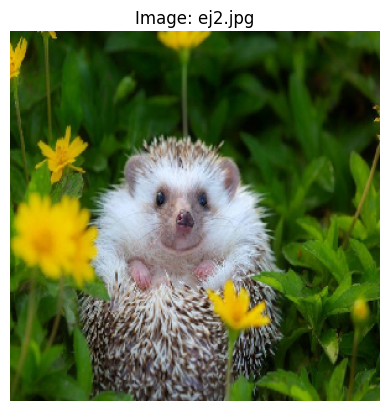

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 104ms/step
[[0.01044014 0.98788506 0.00167486]]
Это ежик!


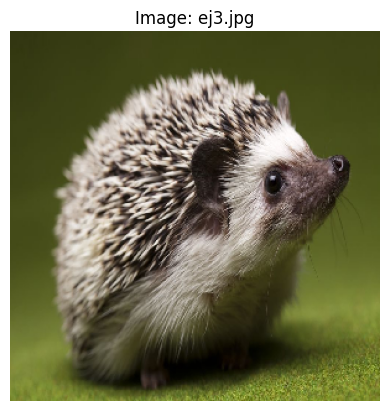

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step
[[0.00292206 0.9072887  0.08978925]]
Это ежик!


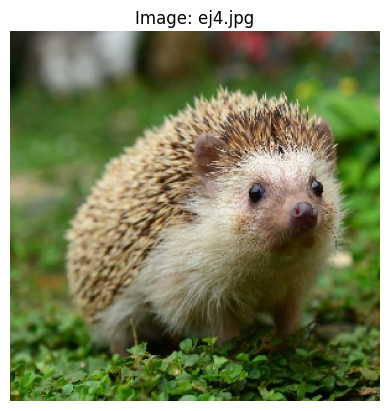

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 104ms/step
[[2.4540845e-02 9.7451854e-01 9.4059540e-04]]
Это ежик!


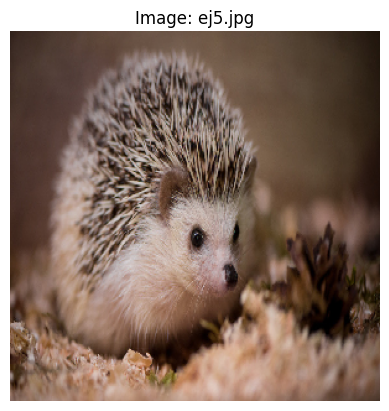

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 108ms/step
[[0.9163359  0.04051863 0.04314548]]
Это бобер!


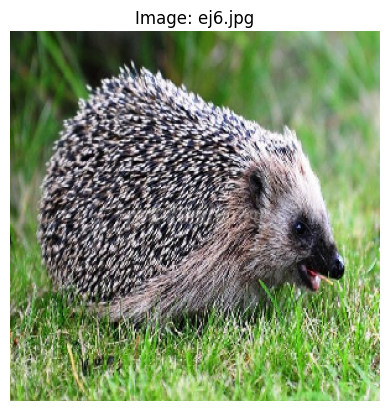

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step
[[0.139648   0.20455138 0.65580064]]
Это дикая кошка!


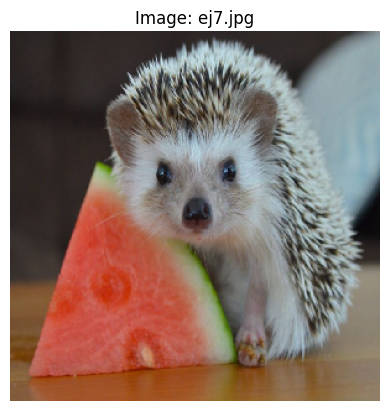

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 189ms/step
[[0.60384035 0.25435078 0.14180884]]
Это бобер!


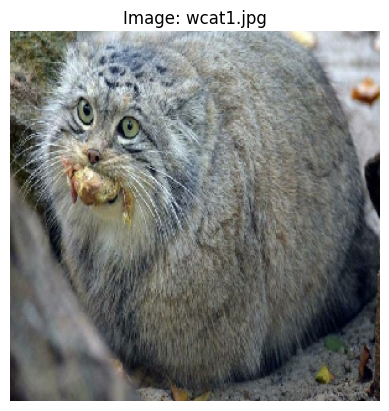

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 180ms/step
[[3.5349295e-01 5.1618559e-07 6.4650655e-01]]
Это дикая кошка!


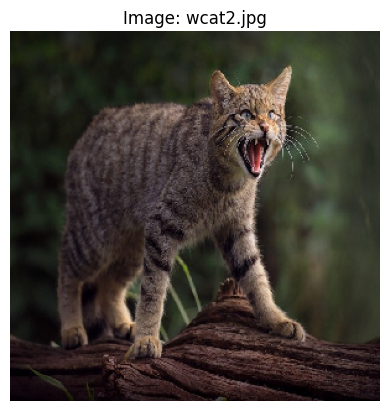

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step
[[0.55755377 0.05715018 0.3852961 ]]
Это бобер!


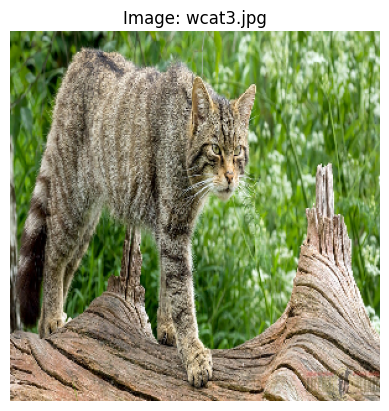

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step
[[0.44453746 0.00244504 0.55301744]]
Это дикая кошка!


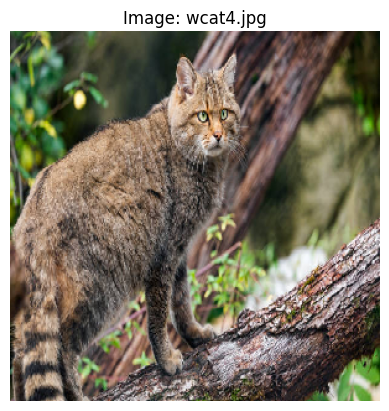

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 145ms/step
[[5.6625684e-03 5.2856285e-07 9.9433690e-01]]
Это дикая кошка!


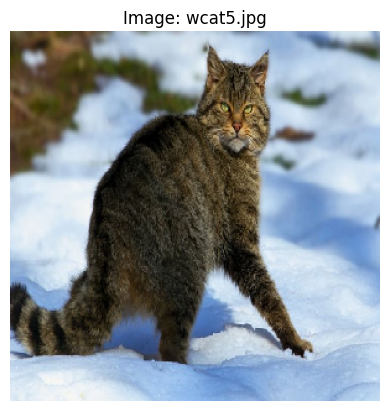

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 183ms/step
[[0.60947263 0.31751677 0.07301065]]
Это бобер!


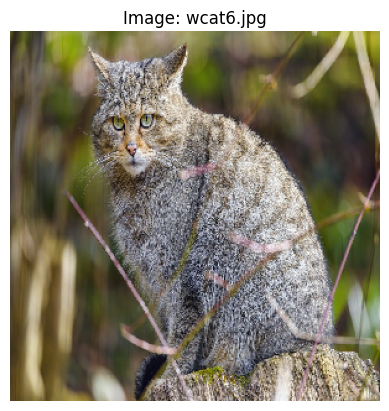

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 189ms/step
[[7.024430e-02 2.227759e-04 9.295330e-01]]
Это дикая кошка!


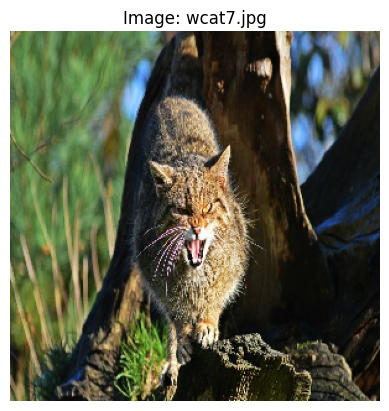

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step
[[4.6554175e-03 4.2102820e-05 9.9530244e-01]]
Это дикая кошка!


In [36]:
from matplotlib import pyplot as plt

for animal in ['bober', 'ej', 'wcat']:
    for i in range(1, 8):
        who_on_image_bober(f'{animal}{i}.jpg', 299, model3)